In [2]:
# import package
import matplotlib.pyplot as plt
import seaborn as sns 
import statsmodels as sm
import folium as fl
import pandas as pd 
from pathlib import Path
from sklearn.impute import SimpleImputer
import geopandas as gpd
import mapclassify as mpc
import warnings
import plotly.offline as py
import plotly.express as px
import cufflinks as cf
import numpy as np

%matplotlib inline
gpd.plotting.plot_linestring_collection
py.init_notebook_mode(connected=False)
cf.set_config_file(offline=True)
sns.set()
warnings.filterwarnings('ignore')

## Data

In [3]:
geofile = './datasets/covid_19_clean_complete.csv'
covidfile = './datasets/covid_19_data.csv'
geospatial = pd.read_csv(geofile, parse_dates=True)
covid19 = pd.read_csv(covidfile, parse_dates=True)

In [4]:
covid19.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 172480 entries, 0 to 172479
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   SNo              172480 non-null  int64  
 1   ObservationDate  172480 non-null  object 
 2   Province/State   124597 non-null  object 
 3   Country/Region   172480 non-null  object 
 4   Last Update      172480 non-null  object 
 5   Confirmed        172480 non-null  float64
 6   Deaths           172480 non-null  float64
 7   Recovered        172480 non-null  float64
dtypes: float64(3), int64(1), object(4)
memory usage: 10.5+ MB


In [5]:
geospatial.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Province/State  14664 non-null  object 
 1   Country/Region  49068 non-null  object 
 2   Lat             49068 non-null  float64
 3   Long            49068 non-null  float64
 4   Date            49068 non-null  object 
 5   Confirmed       49068 non-null  int64  
 6   Deaths          49068 non-null  int64  
 7   Recovered       49068 non-null  int64  
 8   Active          49068 non-null  int64  
 9   WHO Region      49068 non-null  object 
dtypes: float64(2), int64(4), object(4)
memory usage: 3.7+ MB


In [6]:
geospatial['Date'] = pd.DataFrame(geospatial['Date'])
covid19['ObservationDate'] = pd.DataFrame(covid19['ObservationDate'])
covid19['CurrentConfirmed'] = covid19['Confirmed'] - covid19['Deaths'] - covid19['Recovered']

In [7]:
replace = ['Dem. Rep. Congo', "Côte d'Ivoire", 'Congo', 'United Kingdom', 'China','Central African Rep.', 'Eq. Guinea','eSwatini','Bosnia and Herz.', 'S. Sudan', 'Dominican Rep.', 'W. Sahara', 'United States of America']

name = ['Congo (Kinshasa)', 'Ivory Coast', 'Congo (Brazzaville)', 'UK', 'Mainland China', 'Central African Republic', 'Equatorial Guinea', 'Eswatini', 'Bosnia and Herzegovina', 'South Sudan', 'Dominica', 'Western Sahara','US']

In [8]:
geo_data = geospatial.drop(columns=['Province/State'])
covid_data = covid19.drop(columns=['Province/State'])
covid_data = covid_data.replace(to_replace=name, value=replace)
geo_data = geo_data.replace(to_replace=name, value=replace)

# END Cleaning

## Visualizing the Data

In [9]:
gb_covid = covid_data.groupby('ObservationDate')[['Confirmed', 'Deaths', 'Recovered', 'CurrentConfirmed']].agg('sum')
dataCovid = covid_data.groupby(['Country/Region', 'ObservationDate'])[['Confirmed', 'Deaths', 'Recovered', 'CurrentConfirmed']].agg('sum').reset_index()

In [10]:
date = gb_covid.index.max()
total_countries = len(covid_data['Country/Region'].unique())
total_confirmed = gb_covid['Confirmed'][gb_covid.index == gb_covid.index.max()].values[-1]
total_deaths = gb_covid['Deaths'][gb_covid.index==gb_covid.index.max()].values[-1]
total_recover = gb_covid['Recovered'][gb_covid.index ==gb_covid.index.max()].values[-1]
total_curr_confirmed = gb_covid['CurrentConfirmed'][gb_covid.index==gb_covid.index.max()].values[-1]

print(f'COVID-19 WORLDWIDE [latest data: {date}]\n')
print(f'Countries affected: {total_countries}')
print(f'Total Confirmed: {total_confirmed}')
print(f'Total Deaths: {total_deaths}')
print(f'Total Recovered: {total_recover}')
print(f'Total CurrentConfirmed: {total_curr_confirmed}')


COVID-19 WORLDWIDE [latest data: 12/06/2020]

Countries affected: 226
Total Confirmed: 67073728.0
Total Deaths: 1536056.0
Total Recovered: 43103827.0
Total CurrentConfirmed: 22433845.0


In [11]:
gb_covid.Confirmed.iplot(title='TOTAL COVID-19 CASES WORLDWIDE', yTitle='CASES')

In [12]:
geoCovid = gpd.GeoDataFrame(geo_data, geometry=gpd.points_from_xy(geo_data.Long, geo_data.Lat))

In [13]:
geoCovid.crs = 'epsg:4326'

In [14]:
#plot the worldwide covid19
world_path_file = gpd.datasets.get_path('naturalearth_lowres') # upload natural data map
world = gpd.read_file(world_path_file)

In [15]:
need_data = dataCovid[dataCovid.ObservationDate == dataCovid.ObservationDate.max()]

In [16]:
geo_merged = world.merge(need_data[['Country/Region','Confirmed','Deaths','Recovered','CurrentConfirmed']] , left_on='name', right_on='Country/Region')

In [17]:
geo_merged.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 162 entries, 0 to 161
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   pop_est           162 non-null    int64   
 1   continent         162 non-null    object  
 2   name              162 non-null    object  
 3   iso_a3            162 non-null    object  
 4   gdp_md_est        162 non-null    float64 
 5   geometry          162 non-null    geometry
 6   Country/Region    162 non-null    object  
 7   Confirmed         162 non-null    float64 
 8   Deaths            162 non-null    float64 
 9   Recovered         162 non-null    float64 
 10  CurrentConfirmed  162 non-null    float64 
dtypes: float64(5), geometry(1), int64(1), object(4)
memory usage: 15.2+ KB


Text(0.5, 1.0, 'WORLDWIDE COVID-19 CASES')

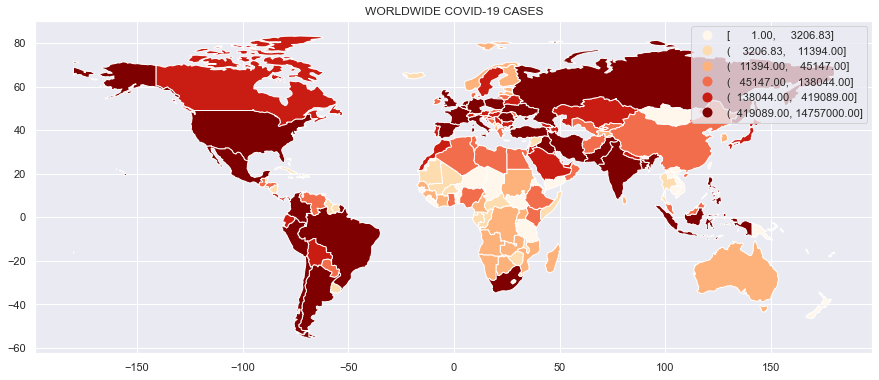

In [18]:
geo_merged.plot(cmap='OrRd', column='Confirmed', legend=True,figsize=(15,10), scheme='quantiles', k=6)
plt.title('WORLDWIDE COVID-19 CASES')

Text(0.5, 1.0, 'COVID-19 GLOBAL DENSITY')

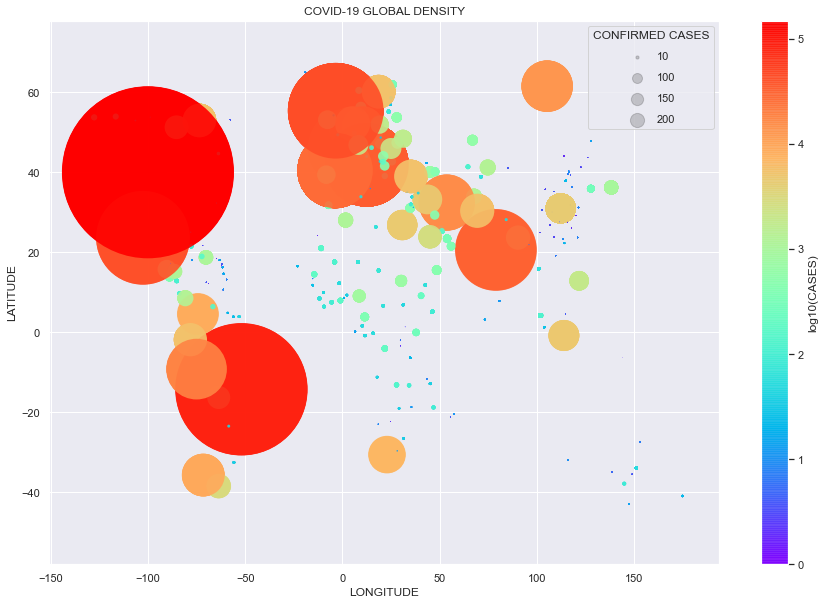

In [19]:
pworld = geoCovid.copy()
lat_world = pworld.Lat
lon_world = pworld.Long
pa_world = pworld.Deaths
patient = geoCovid.Deaths

# Scatter the points, using size and color but no label
plt.figure(figsize=(15,10))
plt.scatter(lon_world, lat_world, label=None, c=np.log10(pa_world+1), cmap='rainbow', s=pa_world/5, linewidth=0, alpha=0.9)
plt.xlabel('LONGITUDE')
plt.ylabel('LATITUDE')
plt.colorbar(label='log10(CASES)')

for id in [10, 100, 150, 200]:
    plt.scatter([], [], c='k', alpha=0.2, s=id, label = str(id))
plt.legend(scatterpoints=1, frameon=True, labelspacing=1, title='CONFIRMED CASES')
plt.title('COVID-19 GLOBAL DENSITY')

Text(0.5, 1.0, 'COVID-19 WORLDWIDE DENSITY')

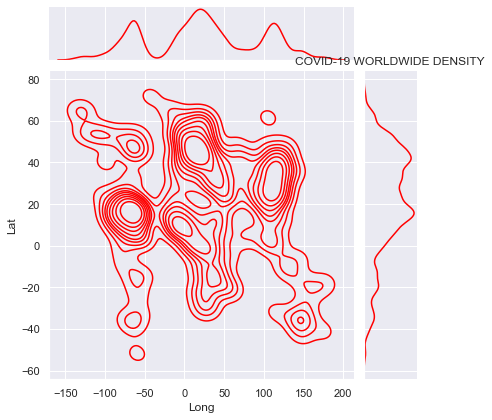

In [20]:
#latitude & longitude
sns.jointplot(x=pworld.Long, y=pworld.Lat, data=pworld, kind='kde', annot_kws=dict(stat="r"), color='red')
plt.title('COVID-19 WORLDWIDE DENSITY')